In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Segmentation

--------------

## Separating an image into one or more regions of interest.

Everyone has heard or seen Photoshop or a similar graphics editor take a person from one image and place them into another.  The first step of doing this is *identifying where that person is in the source image*.

In popular culture, the Terminator's vision segments humans out of the overall scene:

<img src="../images/terminator-vision.png" width="700px"/>

Segmentation is a fundamental operation in scientific image analysis because we often want to measure properties of real, physical *objects* such as cells embedded in our image. As such, we want to find those objects within our image.

Computationally, segmentations are most often represented as images, of the same size as the original image, containing integer *labels*, with one value representing one object.



## imports

In [2]:
import numpy as np
from scipy import ndimage as ndi

import napari

from skimage.segmentation import watershed
from skimage.feature import peak_local_max



## Segmenting nuclei and measuring cell properties

In the rest of this notebook, we will segment nuclei from a small sample image provided by the Allen Institute for Cell Science.

In [2]:
import tifffile


nuclei = tifffile.imread('../images/cells.tif')
membranes = tifffile.imread('../images/cells_membrane.tif')

print("shape: {}".format(nuclei.shape))
print("dtype: {}".format(nuclei.dtype))
print("range: ({}, {})".format(np.min(nuclei), np.max(nuclei))) 



from aicsimageio import AICSImage, exceptions
from aicsimageio.dimensions import DimensionNames

filename = "/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N05_Unmixed.czi"

shape: (60, 256, 256)
dtype: float64
range: (0.0, 1.0)


In [3]:


from aicsimageio import AICSImage, exceptions
from aicsimageio.dimensions import DimensionNames

from aicsimageio.readers import czi_reader
from aicspylibczi import CziFile


filename = "/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N05_Unmixed.czi"

In [48]:
czi_file = CziFile(filename)

czi_reader.CziReader.metadata.getter


<function property.getter>

In [5]:


from pathlib import Path
from aicsimageio import AICSImage, exceptions
from aicsimageio.dimensions import DimensionNames

filename = "/Users/ahenrie/Projects/Imaging/mcz_subcell/data/ZSTACK_PBTOhNGN2hiPSCs_BR3_N16_Unmixed.czi"
path = Path(filename)
img = AICSImage(path)

In [49]:

print("shape: {}".format(img.shape))
print("dtype: {}".format(img.dtype))
print("range: ({}, {})".format(np.min(img), np.max(img))) 
img.physical_pixel_sizes


shape: (1, 8, 14, 768, 768)
dtype: uint16
range: (<AICSImage [Reader: CziReader, Image-is-in-Memory: True]>, <AICSImage [Reader: CziReader, Image-is-in-Memory: True]>)


PhysicalPixelSizes(Z=0.5804527163320905, Y=0.07987165184837318, X=0.07987165184837318)

In [50]:
from collections import defaultdict

def etree_to_dict(t):
    d = {t.tag: {} if t.attrib else None}
    children = list(t)
    if children:
        dd = defaultdict(list)
        for dc in map(etree_to_dict, children):
            for k, v in dc.items():
                dd[k].append(v)
        d = {t.tag: {k: v[0] if len(v) == 1 else v
                     for k, v in dd.items()}}
    if t.attrib:
        d[t.tag].update(('@' + k, v)
                        for k, v in t.attrib.items())
    if t.text:
        text = t.text.strip()
        if children or t.attrib:
            if text:
                d[t.tag]['#text'] = text
        else:
            d[t.tag] = text
    return d


TypeError: element indices must be integers

In [51]:
meta_data = img.metadata
type(meta_data)

xml.etree.ElementTree.Element

In [65]:

meta_data = img.metadata
#Use function above to convert xml to dict
meta_dict = etree_to_dict(metadata)
meta = meta_dict['ImageDocument']['Metadata']

In [68]:
meta['Experiment']

{'ExperimentBlockIndex': '0',
 'ExperimentBlocks': {'AcquisitionBlock': {'AcquisitionModeSetup': {'BiDirectional': 'true',
    'BiDirectionalZ': 'false',
    'BitsPerSample': '16',
    'CameraBinning': '1',
    'CameraFrameHeight': '1030',
    'CameraFrameOffsetX': '0',
    'CameraFrameOffsetY': '0',
    'CameraFrameWidth': '1300',
    'CameraSuperSampling': '0',
    'DimensionT': '100',
    'DimensionX': '768',
    'DimensionY': '768',
    'DimensionZ': '14',
    'FilterMethod': 'Average',
    'FilterMode': 'Line',
    'FilterSamplingNumber': '1',
    'FitFramesizeToRoi': 'false',
    'HdrEnabled': 'false',
    'HdrImagingMode': '0',
    'HdrIntensity': '1',
    'HdrNumFrames': '1',
    'InterpolationY': '1',
    'Objective': 'Plan-Apochromat 63x/1.40 Oil DIC M27',
    'OffsetX': '1.8610283702542929e-006',
    'OffsetY': '-7.4441134810171716e-006',
    'OffsetZ': '3.7728853123171575e-006',
    'ReferenceZ': '0.0058349729999999994',
    'PixelPeriod': '1.6060606060606061e-006',
    'Ro

In [95]:
import aicsimageio
import shutil 

py_root = Path(shutil.which("python"))

hardlink = py_root.parent.parent /  "lib/python3.9/site-packages/aicsimageio/metadata/czi-to-ome-xslt/xslt/czi-to-ome.xsl"

aicsimageio.readers.czi_reader.metadata_utils.transform_metadata_with_xslt(img.metadata, hardlink)

/opt/anaconda3/envs/napariCPU/lib/python3.9/site-packages/ome_types/_convenience.py:105: FutureWarning: The default XML parser will be changing from 'xmlschema' to 'lxml' in version 0.4.0.  To silence this warning, please provide the `parser` argument, specifying either 'lxml' (to opt into the new behavior), or'xmlschema' (to retain the old behavior).
  d = to_dict(os.fspath(xml), parser=parser, validate=validate)


XMLSchemaValidationError: failed validating '' with XsdEnumerationFacets(['WideField', 'LaserScanningConfocalMicroscopy', 'SpinningDiskConfocal', 'SlitScanConfocal', 'MultiPhotonMicroscopy', ...]):

Reason: attribute AcquisitionMode='': value must be one of ['WideField', 'LaserScanningConfocalMicroscopy', 'SpinningDiskConfocal', 'SlitScanConfocal', 'MultiPhotonMicroscopy', 'StructuredIllumination', 'SingleMoleculeImaging', 'TotalInternalReflection', 'FluorescenceLifetime', 'SpectralImaging', 'FluorescenceCorrelationSpectroscopy', 'NearFieldScanningOpticalMicroscopy', 'SecondHarmonicGenerationImaging', 'PALM', 'STORM', 'STED', 'TIRF', 'FSM', 'LCM', 'Other', 'BrightField', 'SweptFieldConfocal', 'SPIM']

Schema:

  <xsd:enumeration xmlns:xsd="http://www.w3.org/2001/XMLSchema" value="WideField" />

Instance:

  <ome:Channel xmlns:ome="http://www.openmicroscopy.org/Schemas/OME/2016-06" ID="Channel:7-0" Name="Residuals" AcquisitionMode="" ExcitationWavelength="NaN" ExcitationWavelengthUnit="nm" EmissionWavelength="NaN" EmissionWavelengthUnit="nm"><ome:DetectorSettings ID="" Binning="Other" /></ome:Channel>

Path: /ome:OME/ome:Image/ome:Pixels/ome:Channel[8]


In [88]:
hardlink.is_file(), py_root, hardlink

(True,
 PosixPath('/opt/anaconda3/envs/napariCPU/bin/python'),
 PosixPath('/opt/anaconda3/envs/napariCPU/lib/python3.9/site-packages/aicsimageio/metadata/czi-to-ome-xslt/xslt/czi-to-ome.xsl'))

In [28]:
img.channel_names

['Nuclei_Jan22',
 'Lyso+405_Jan22',
 'Mito+405_Jan22',
 'Golgi+405_Jan22',
 'Peroxy+405_Jan22',
 'ER+405_Jan22',
 'BODIPY+405low_Jan22',
 'Residuals']

In [31]:
type(img.data)


numpy.ndarray

In [45]:
md = img.ome_metadata

XMLSchemaValidationError: failed validating '' with XsdEnumerationFacets(['WideField', 'LaserScanningConfocalMicroscopy', 'SpinningDiskConfocal', 'SlitScanConfocal', 'MultiPhotonMicroscopy', ...]):

Reason: attribute AcquisitionMode='': value must be one of ['WideField', 'LaserScanningConfocalMicroscopy', 'SpinningDiskConfocal', 'SlitScanConfocal', 'MultiPhotonMicroscopy', 'StructuredIllumination', 'SingleMoleculeImaging', 'TotalInternalReflection', 'FluorescenceLifetime', 'SpectralImaging', 'FluorescenceCorrelationSpectroscopy', 'NearFieldScanningOpticalMicroscopy', 'SecondHarmonicGenerationImaging', 'PALM', 'STORM', 'STED', 'TIRF', 'FSM', 'LCM', 'Other', 'BrightField', 'SweptFieldConfocal', 'SPIM']

Schema:

  <xsd:enumeration xmlns:xsd="http://www.w3.org/2001/XMLSchema" value="WideField" />

Instance:

  <ome:Channel xmlns:ome="http://www.openmicroscopy.org/Schemas/OME/2016-06" ID="Channel:7-0" Name="Residuals" AcquisitionMode="" ExcitationWavelength="NaN" ExcitationWavelengthUnit="nm" EmissionWavelength="NaN" EmissionWavelengthUnit="nm"><ome:DetectorSettings ID="" Binning="Other" /></ome:Channel>

Path: /ome:OME/ome:Image/ome:Pixels/ome:Channel[8]


The pixel spacing in this dataset is 0.29µm in the z (leading!) axis, and 0.26µm in the x and y axes.

In [3]:
spacing = np.array([0.29, 0.26, 0.26])

We can view the 3D image using napari.

In [4]:
viewer = napari.view_image(
    nuclei,
    contrast_limits=[0, 1],
    scale=spacing,
    ndisplay=3,
)

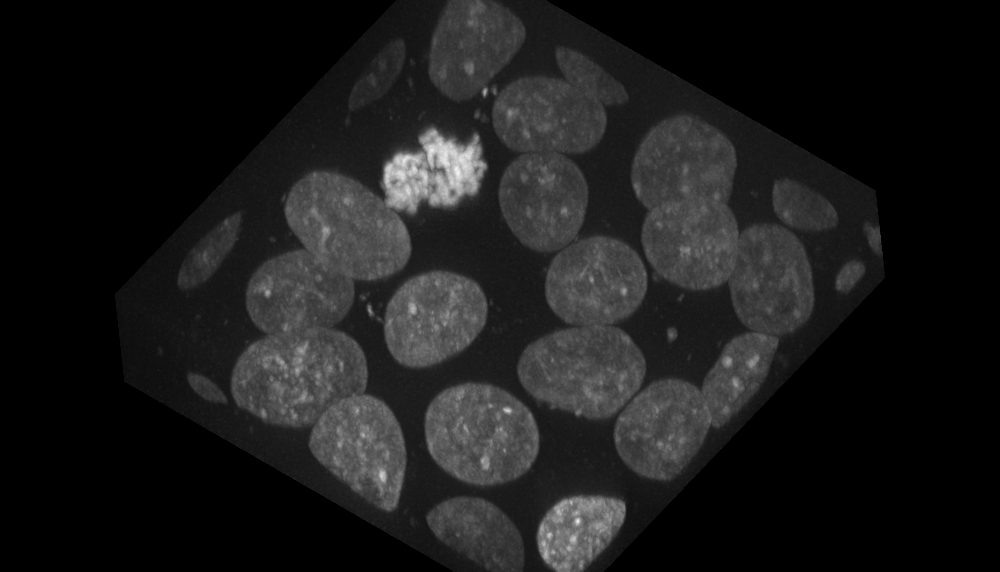

In [5]:
from napari.utils.notebook_display import nbscreenshot

viewer.dims.ndisplay = 3
viewer.camera.angles = (-30, 25, 120)
nbscreenshot(viewer, canvas_only=True)

## Edge detection

We saw the [Sobel operator](https://en.wikipedia.org/wiki/Sobel_operator) in the filters lesson. It is an edge detection algorithm that approximates the gradient of the image intensity, and is fast to compute. The [Scharr filter](https://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.scharr) is a slightly more sophisticated version, with smoothing weights [3, 10, 3]. Both work for n-dimensional images in scikit-image.

In [6]:
from skimage import filters


edges = filters.scharr(nuclei)

nuclei_layer = viewer.layers['nuclei']
nuclei_layer.blending = 'additive'
nuclei_layer.colormap = 'green'

viewer.add_image(
    edges,
    scale=spacing,
    blending='additive',
    colormap='magenta',
)

<Image layer 'edges' at 0x107dbcfa0>

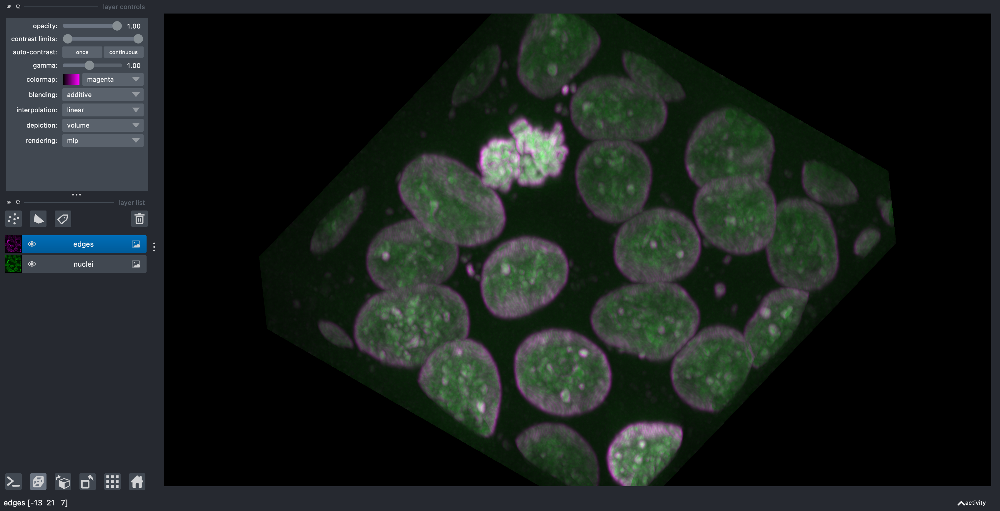

In [7]:
nbscreenshot(viewer)

## Thresholding

[Thresholding](https://en.wikipedia.org/wiki/Thresholding_%28image_processing%29) is used to create binary images. A threshold value determines the intensity value separating foreground pixels from background pixels. Foregound pixels are pixels brighter than the threshold value, background pixels are darker. In many cases, images can be adequately segmented by thresholding followed by labelling of *connected components*, which is a fancy way of saying "groups of pixels that touch each other".

Different thresholding algorithms produce different results. [Otsu's method](https://en.wikipedia.org/wiki/Otsu%27s_method) and [Li's minimum cross entropy threshold](https://scikit-image.org/docs/dev/auto_examples/developers/plot_threshold_li.html) are two common algorithms. Below, we use Li. You can use `skimage.filters.threshold_<TAB>` to find different thresholding methods.

In [9]:
denoised = ndi.median_filter(nuclei,    size=3  )

In [10]:
li_thresholded = denoised > filters.threshold_li(denoised)

In [11]:
viewer.add_image(
    li_thresholded,
    scale=spacing,
    opacity=0.3,
)

<Image layer 'li_thresholded' at 0x16d843ca0>

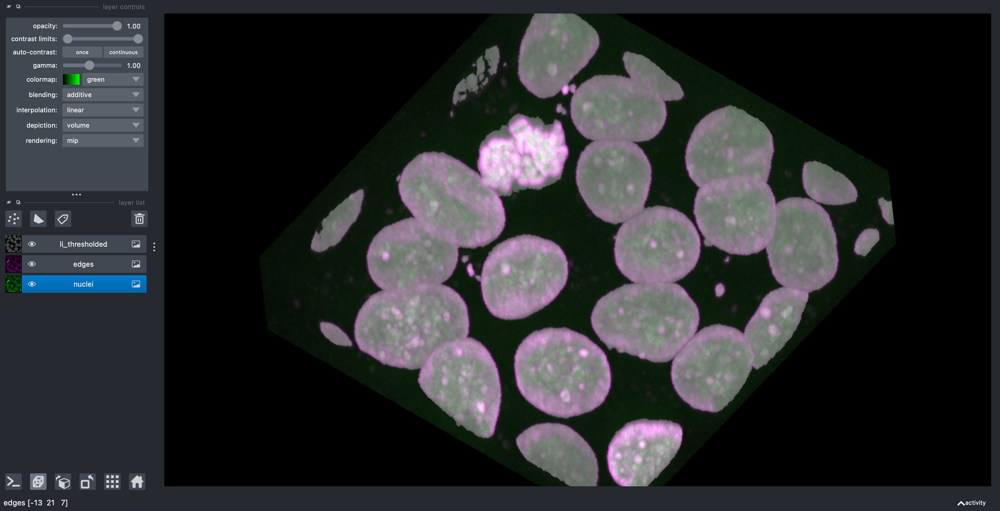

In [12]:
nbscreenshot(viewer)

## Morphological operations

[Mathematical morphology](https://en.wikipedia.org/wiki/Mathematical_morphology) operations and structuring elements are defined in `skimage.morphology`. Structuring elements are shapes which define areas over which an operation is applied. The response to the filter indicates how well the neighborhood corresponds to the structuring element's shape.

There are a number of two and three dimensional structuring elements defined in `skimage.morphology`. Not all 2D structuring element have a 3D counterpart. The simplest and most commonly used structuring elements are the `disk`/`ball` and `square`/`cube`.

Functions operating on [connected components](https://en.wikipedia.org/wiki/Connected_space) can remove small undesired elements while preserving larger shapes.

`skimage.morphology.remove_small_holes` fills holes and `skimage.morphology.remove_small_objects` removes bright regions. Both functions accept a size parameter, which is the minimum size (in pixels) of accepted holes or objects. It's useful in 3D to think in linear dimensions, then cube them. In this case, we remove holes / objects of the same size as a cube 20 pixels across.

In [13]:
from skimage import morphology

In [14]:
width = 20

remove_holes = morphology.remove_small_holes(
    li_thresholded, width ** 3
)

In [15]:
width = 20

remove_objects = morphology.remove_small_objects(
    remove_holes, width ** 3
)

viewer.add_image(
    remove_objects,
    name='cleaned',
    scale=spacing,
    opacity=0.3,
);

viewer.layers['li_thresholded'].visible = False

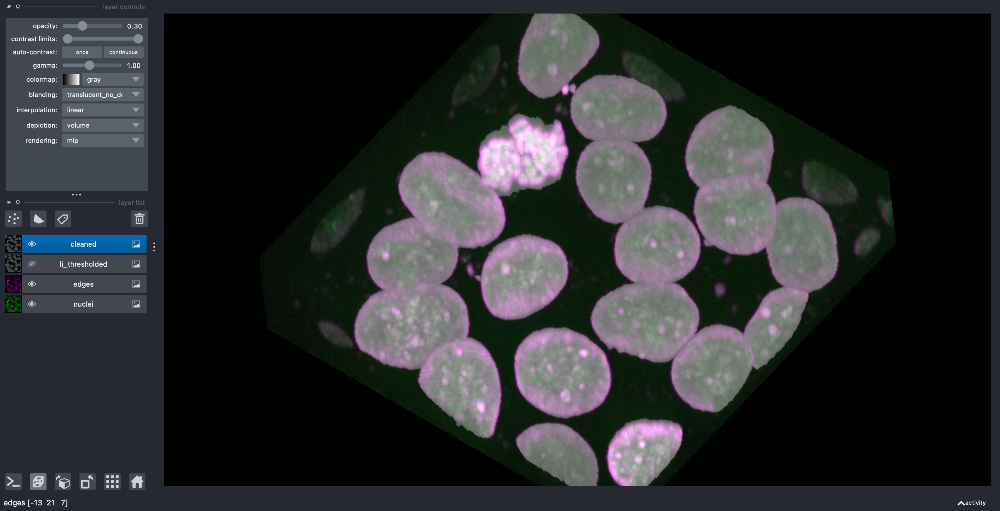

In [16]:
nbscreenshot(viewer)

## Segmentation

Now we are ready to label the connected components of this image.

In [17]:
from skimage import measure

labels = measure.label(remove_objects)

viewer.add_labels(
    labels,
    scale=spacing,
    opacity=0.5,
)

viewer.layers['cleaned'].visible = False

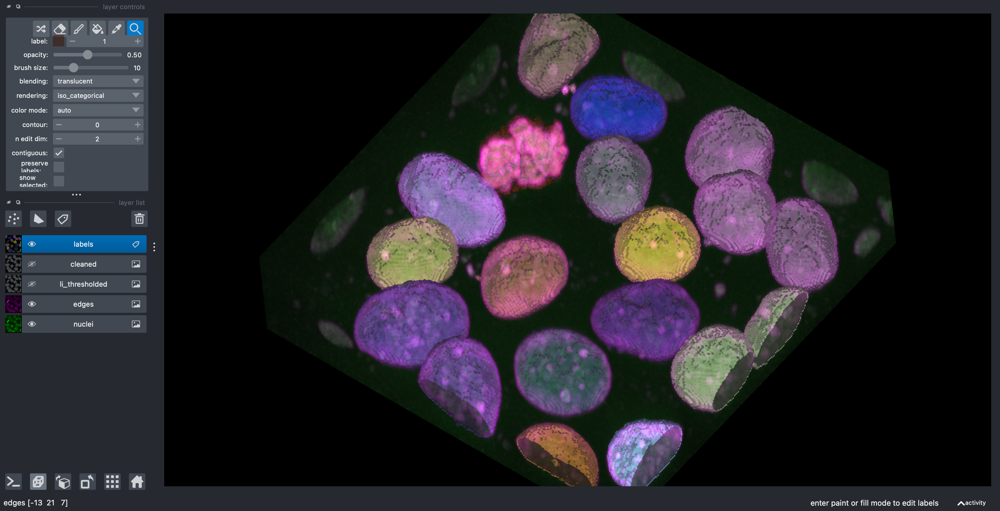

In [18]:
nbscreenshot(viewer)

We can see that tightly packed cells connected in the binary image are assigned the same label.

A better segmentation would assign different labels to different nuclei. 

Typically we use [watershed segmentation](https://en.wikipedia.org/wiki/Watershed_%28image_processing%29) for this purpose. We place *markers* at the centre of each object, and these labels are expanded until they meet an edge or an adjacent marker.

The trick, then, is how to find these markers. It can be quite challenging to find markers with the right location. A slight amount of noise in the image can result in very wrong point locations. Here is a common approach: find the distance from the object boundaries, then place points at the maximal distance.

In [19]:
transformed = ndi.distance_transform_edt(remove_objects, sampling=spacing)

maxima = morphology.local_maxima(transformed)
viewer.add_points(
    np.transpose(np.nonzero(maxima)),
    name='bad points',
    scale=spacing,
    size=4,
    n_dimensional=True,  # points have 3D "extent"
)

<Points layer 'bad points' at 0x16d94faf0>

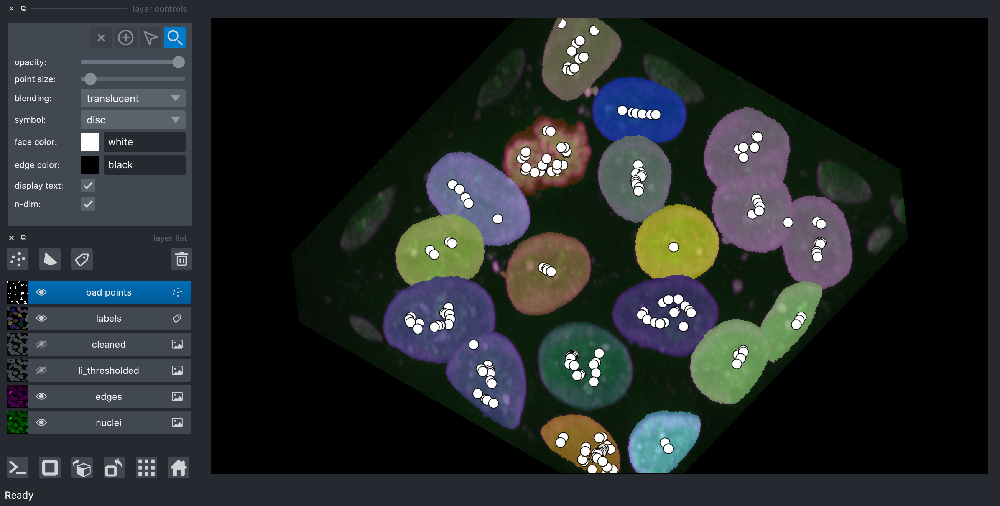

In [20]:
#nbscreenshot(viewer)  #did the conventions change for how points/labels render?  my picture has teh "bad points" obscured

You can see that these points are actually terrible, with many markers found within each nuclei.

### <span style="color:cornflowerblue">Exercise: improve the points</span>

Try to improve the segmentation to assign one point for each nucleus. Some ideas:

- use a smoothed version of the nuclei image directly
- smooth the distance map
- use morphological operations to smooth the surface of the nuclei to ensure that they are close to spherical
- use peak_local_max with `min_distance` parameter instead of `morphology.local_maxima`
- find points on a single plane, then prepend the plane index to the found coordinates

In [20]:
transformed = ndi.distance_transform_edt(remove_objects, sampling=spacing)
transformed = filters.gaussian(transformed, 10)

maxima = morphology.local_maxima(transformed)
viewer.add_points(
    np.transpose(np.nonzero(maxima)),
    name='bad points',
    scale=spacing,
    size=4,
    n_dimensional=True,  # points have 3D "extent"
)

<Points layer 'bad points [1]' at 0x16ddb2b20>

As you will have seen from the previous exercise, there are many approaches to find better seed points, but they are often fiddly and tedious, and sensitive to parameters — when you encounter a new image, you might have to start all over again!

With napari, in many cases, a little interactivity, combined with the segmentation algorithms in scikit-image and elsewhere, can quickly get us the segmentation we want.

Below, you can use full manual annotation, or light editing of the points you found automatically.

In [29]:
viewer.layers['bad points'].visible = False
viewer.dims.ndisplay = 2
viewer.dims.set_point(0, 30 * spacing[0])

points = viewer.add_points(
    name='interactive points',
    scale=spacing,
    ndim=3,
    size=4,
    n_dimensional=True,
)
points.mode = 'add'


# now, we annotate the centers of the nuclei in your image

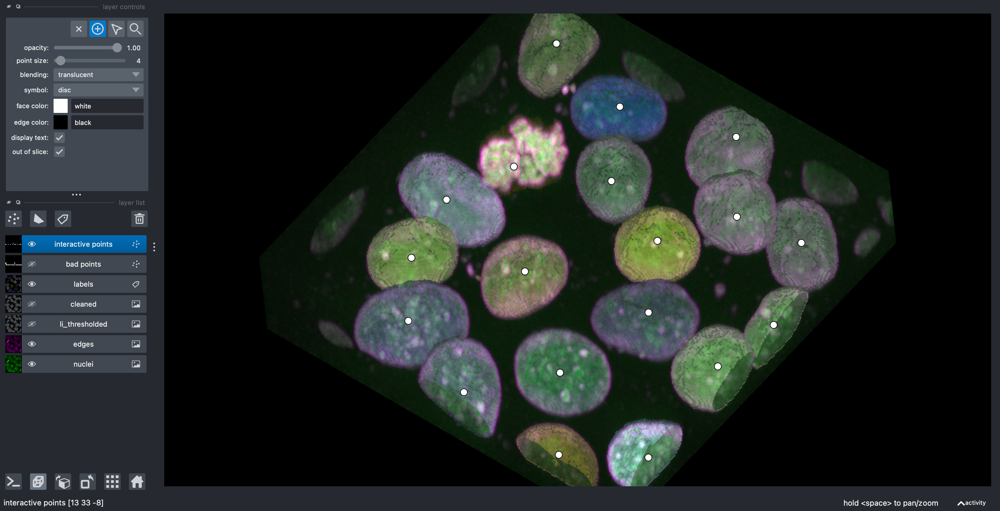

In [31]:
viewer.dims.ndisplay = 3
viewer.camera.angles = (-30, 25, 120)
nbscreenshot(viewer)

In [32]:
# unscaled points.data
# this cell is only to simulate interactive annotation,
# no need to run it if you already have annotations.


# points.data = np.array(
#       [[ 30.        ,  14.2598685 ,  27.7741219 ],
#        [ 30.        ,  30.10416663,  81.36513029],
#        [ 30.        ,  13.32785096, 144.27631406],
#        [ 30.        ,  46.8804823 , 191.80920846],
#        [ 30.        ,  43.15241215, 211.84758551],
#        [ 30.        ,  94.87938547, 160.12061219],
#        [ 30.        ,  72.97697335, 112.58771779],
#        [ 30.        , 138.21820096, 189.01315585],
#        [ 30.        , 144.74232372, 242.60416424],
#        [ 30.        ,  98.14144685, 251.92433962],
#        [ 30.        , 153.59649032, 112.58771779],
#        [ 30.        , 134.49013081,  40.35635865],
#        [ 30.        , 182.95504275,  48.74451649],
#        [ 30.        , 216.04166532,  80.89912152],
#        [ 30.        , 235.14802483, 130.296051  ],
#        [ 30.        , 196.00328827, 169.44078757],
#        [ 30.        , 245.86622651, 202.06140137],
#        [ 30.        , 213.71162148, 250.52631331],
#        [ 28.        ,  87.42324517,  52.00657787]],
#       dtype=float,
# )

Once you have marked all the points, you can grab the data back, and make a markers image for `skimage.segmentation.watershed`:

In [33]:
from skimage import segmentation

marker_locations = points.data

markers = np.zeros(nuclei.shape, dtype=np.uint32)
marker_indices = tuple(np.round(marker_locations).astype(int).T)
markers[marker_indices] = np.arange(len(marker_locations)) + 1
markers_big = morphology.dilation(markers, morphology.ball(5))

segmented = segmentation.watershed(
    edges,
    markers_big,
    mask=remove_objects,
)

viewer.add_labels(
    segmented,
    scale=spacing,
)

viewer.layers['labels'].visible = False

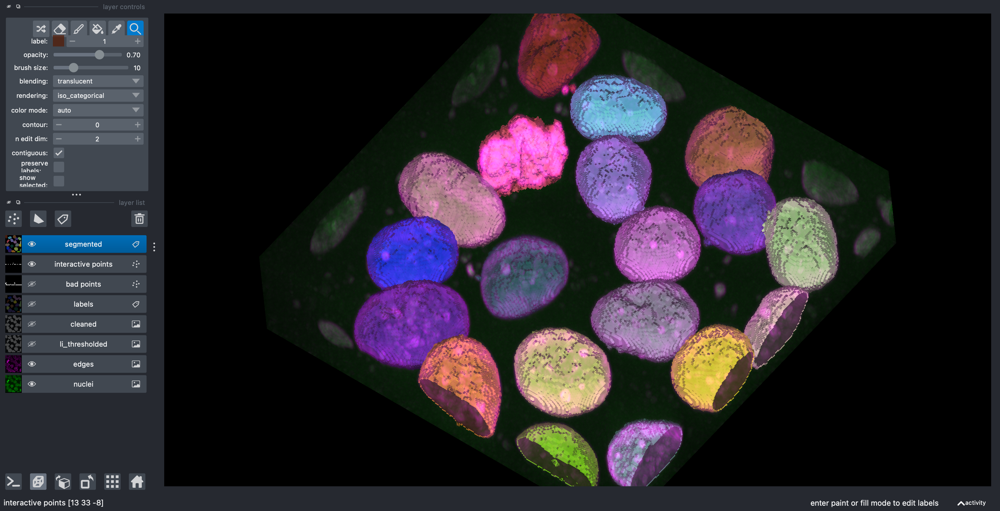

In [34]:
nbscreenshot(viewer)

After watershed, we have better disambiguation between internal cells!

## Making measurements

Once we have defined our objects, we can make measurements on them using `skimage.measure.regionprops` and the new `skimage.measure.regionprops_table`. These measurements include features such as area or volume, bounding boxes, and intensity statistics.

Before measuring objects, it helps to clear objects from the image border. Measurements should only be collected for objects entirely contained in the image.

Given the layer-like structure of our data, we only want to clear the objects touching the sides of the volume, but not the top and bottom, so we pad and crop the volume along the 0th axis to avoid clearing the mitotic nucleus.

In [35]:
segmented_padded = np.pad(
    segmented,
    ((1, 1), (0, 0), (0, 0)),
    mode='constant',
    constant_values=0,
)

In [36]:
interior_labels = segmentation.clear_border(segmented_padded)[1:-1]

`skimage.measure.regionprops` automatically measures many labeled image features. Optionally, an `intensity_image` can be supplied and intensity features are extracted per object. It's good practice to make measurements on the original image.

Not all properties are supported for 3D data. Below we build a list of supported and unsupported 3D measurements.

In [37]:
regionprops = measure.regionprops(interior_labels, intensity_image=nuclei)

supported = [] 
unsupported = []

for prop in regionprops[0]:
    try:
        regionprops[0][prop]
        supported.append(prop)
    except NotImplementedError:
        unsupported.append(prop)

print("Supported properties:")
print("  " + "\n  ".join(supported))
print()
print("Unsupported properties:")
print("  " + "\n  ".join(unsupported))

Supported properties:
  area
  area_bbox
  area_convex
  area_filled
  axis_major_length
  axis_minor_length
  bbox
  centroid
  centroid_local
  centroid_weighted
  centroid_weighted_local
  coords
  equivalent_diameter_area
  euler_number
  extent
  feret_diameter_max
  image
  image_convex
  image_filled
  image_intensity
  inertia_tensor
  inertia_tensor_eigvals
  intensity_max
  intensity_mean
  intensity_min
  label
  moments
  moments_central
  moments_normalized
  moments_weighted
  moments_weighted_central
  moments_weighted_normalized
  slice
  solidity

Unsupported properties:
  eccentricity
  moments_hu
  moments_weighted_hu
  orientation
  perimeter
  perimeter_crofton


scikit-image 0.18 adds support for [passing custom functions](https://scikit-image.org/docs/dev/api/skimage.measure.html#skimage.measure.regionprops) for region properties as `extra_properties`. After this tutorial, you might want to try it out to [determine the surface area](https://github.com/scikit-image/scikit-image/issues/3797#issuecomment-471277056) of the nuclei or cells!

`skimage.measure.regionprops` ignores the 0 label, which represents the background.

`regionprops_table` returns a dictionary of columns compatible with creating a pandas dataframe of properties of the data:

In [38]:
import pandas as pd


info_table = pd.DataFrame(
    measure.regionprops_table(
        interior_labels,
        intensity_image=nuclei,
        properties=['label', 'slice', 'area', 'mean_intensity', 'solidity'],
    )
).set_index('label')

In [39]:
info_table.head()

,slice,area,mean_intensity,solidity
label,,,,
2,"(slice(20, 53, None), slice(13, 55, None), sli...",37410,0.189264,0.930666
3,"(slice(19, 51, None), slice(47, 99, None), sli...",40504,0.185613,0.911985
5,"(slice(19, 55, None), slice(26, 71, None), sli...",36054,0.211766,0.922923
6,"(slice(20, 52, None), slice(23, 75, None), sli...",36993,0.181161,0.913002
7,"(slice(19, 54, None), slice(72, 121, None), sl...",40130,0.211141,0.894242


We can now use pandas and seaborn for some analysis!

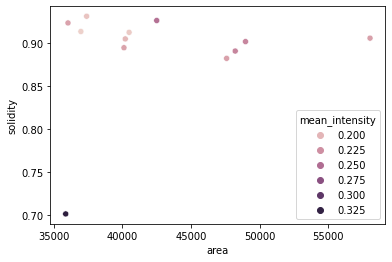

In [41]:
import seaborn as sns

sns.scatterplot(x='area', y='solidity', data=info_table, hue='mean_intensity');

We can see that the mitotic nucleus is a clear outlier from the others in terms of solidity and intensity.

### <span style="color:cornflowerblue">Exercise: physical measurements</span>

The "area" property above is actually the volume of the region, measured in voxels. Add a new column to your dataframe, `'area_um3'`, containing the volume in µm&sup3;.

In [42]:
info_table['area_um3'] = info_table['area'] * 0.29 * 0.26 * 0.26

In [43]:
info_table['area_um3']

label
2      733.385640
3      794.040416
5      706.802616
6      725.210772
7      786.708520
8      933.228816
10     960.184316
11     833.444456
12     945.520524
13     788.590504
14    1137.933784
19     703.489540
Name: area_um3, dtype: float64

### <span style="color:cornflowerblue">Exercise: full cell segmentation</span>

Above, we loaded the membranes image into memory, but we have yet to use it.

- Add the membranes to the image.
- Use watershed to segment the full cells, and add the segmentation to the display

### <span style="color:cornflowerblue">Exercise: displaying regionprops (or other values)</span>

Now that you have segmented cells, (or even with just the nuclei), use [`skimage.util.map_array`](https://scikit-image.org/docs/dev/api/skimage.util.html#skimage.util.map_array) to display a volume of the value of a regionprop (say, 'solidity' of the cells) on top of the segments.